#DT2470 Lab 02: Synchronization and rhythm

by Andre Holzapfel

In this lab you will choose to **either** do exercises regarding synchronization (chapter 3), **or** rhythm and tempo processing (chapter 6). We agree that doing both would be too much work (for this year), but you will have the code for the solutions for both anyway!

Again, you can use whatever software you want for your own implementation, but I use python in my explanations, and two external libraries in python need to be used in this Lab. Just as Bob, I am basically learning Python by working on this lab, so excuse my bad programming. (I am a bad programmer independent of language, anyway.)

Your task is to reproduce all shown figures with your code (or show the equivalent plots for your own audio files, if you use different ones). Also, provide short answers to the questions in the text.

##Audio samples:

In my examples I use file from the following google folder:

https://drive.google.com/drive/folders/1TGj4ZcEgdGXt9Eko2qViiiKWkUDDewbL?usp=sharing

You can copy these files to your own google folder and use them as explained in Lab 1.

At some points I will ask you to use some audio examples of your own. Be creative...the goal is to check where systems work or fail, and understand (to some extent) those behaviors.

## Code preparations

As for Lab 1, you need to have some external libraries also here:

In [1]:
# Install a python library for working with audio files, named pydub

!pip install pydub



In [1]:
#other preparations!
import os, sys
from scipy import signal
import pydub
import matplotlib
import matplotlib.pyplot as plt
import numpy as np

### Google drive:

you need to adapt the following code to use the audio files that you copied to your google drive.

In [ ]:
import termios
from google.colab import drive
#drive.mount('/content/gdrive')

#https://drive.google.com/drive/folders/1Lmtkv2Rse8RkI1GLAZSjNNegE0K5PCz2?usp=sharing

# 1. Synchronisation

Complete the tasks in this part, if you want to focus on the synchronisation (but have a look at the rhythm part below before you decide!).

## Part 1.1 Warming up

Choose two music sound files that can be considered as interpretations of the same "tune". In my example I used the cmajor_piano.wav and Cmajor_sung.wav, where a C-major scale is performed, once on piano and once sung. For the beginning, choose some excerpts, and not complete pieces, in order to get started.

Read the sound files to a numpy array, and plot the two waveforms. (You did that in Lab 1 too).

Below the waveform I get for the piano file: ![waveform](https://drive.google.com/uc?id=1nt5lUZ1IWO8nWDx2mTdddz2pI9CuBfTq)


## Part 1.2 Compute the spectral magnitude

For both signals compute a Short-time Fourier transform (STFT), and plot their magnitude spectra (as in equation 3.1. Use the code from Lab 1 as starting point). Note: Since you are focusing on tonal content in the Chroma features, use a long window (about 100ms).

The magnitude spectrum for the piano example is shown below. 

Question: why do we see so few high-frequency components? (Hint: in lab 1 you plotted db magnitude spectra).

![](https://drive.google.com/uc?id=1_fEgRgIG0pPzCiNa6Pqz5lDfk-vfGloX)

## Part 1.3 Compute a log-frequency spectrogram

Now, transform the linear frequency axis into a logarithmic one (equation 3.4), and plot the resulting log-frequency spectra for both signals.

Hint: you need to assign the frequencies of the STFT coefficients to the desired pitch bins of the 12-tone resolution (equations 3.2 and 3.3, and the related text in the book help). Unless you are a good numpy programmer (I am not), you will need some loop in that code...

My piano log-f spectrogram looks as shown below.

Question: why do the low-frequency regions look so spread-out and smeary?

![](https://drive.google.com/uc?id=1pxHK7CVEX438DB4BAASGEiU3Qi-hw3Sc)



## Compute the chromagram

The chromagram is a feature that captures well harmonic and melodic development in a sound file. You will compute these features, to apply a synchronization (DTW) algorithm to them.



1.   Compute the chromagram according to equation 3.6

![](https://drive.google.com/uc?id=1Hj26wZ2WHufe1DkZqZoFrJ06kS7y8msS)

2.   Apply logarithmic compression to the chromagram. This will be your input feature for the DTW (my example uses gamma=100).

![](https://drive.google.com/uc?id=1eX8WhSmn6XxI8sIXxfRxdnssSrf2kICT)







## Part 1.4 Compute the synchronization

To this end, you will use the DTW as provided by the librosa library. You can see how to use it in the following code:

https://librosa.github.io/librosa_gallery/auto_examples/plot_music_sync

You can use your two computed chromagrams as inputs X and Y to this function, as they are. Compute the synchronization, and plot the path over the obtained cost matrix D. Your code should start somehow like:

In [ ]:
import librosa
import librosa.display
D, wp = librosa.core.dtw(X=chromagram, Y=chromagram2, metric='cosine')

The plot I obtain when synchronizing the piano and the voice example:

![](https://drive.google.com/uc?id=1RRtacUyBpbXQ8QMEgitRdSuLaH61MAGr)

## Part 1.5 Compute the same alignment using the chroma features from librosa

OK, we went by the course book when computing the features above. Now let us use the librosa library, to compare with our implementation.

To this end, you can copy/paste and edit the code from the librosa example provided above, and compute the plots!

The chroma features look less noisy for me, probably because I used the logarithmic compression with a bad parameter. Note that the book says that all the parameters need to be adapted with care (which some people might call feature engineering):

![](https://drive.google.com/uc?id=1lxDS13V7f_azktMmJP5e9NUvQrp2KQ0c)

After that the warping path looks as follows for me:

![](https://drive.google.com/uc?id=1K5F9XnD6iyDudo1R9V4oCgmCYTqTzju8)

Finally, also compute the alignment visualization between the waveforms, as done in the librosa example. Mine looks as follows:

![](https://drive.google.com/uc?id=1feMM7D7w4uK3UajklQm849X3mDPtdkRU)



## Part 1.6 Last task: conclude, explore



1.   Compare the alignment obtained from "your" features with those using the librosa features, are they different? If yes, why do you think?
2.   Replace the two simple sound files by two complete songs. You can use the Kafene1 and Kafene2 files in the shared folder, or some other song you like more. Compute the alignment, using the librosa features and provide a plot of the alignment curve. Did it work?
3. Find two files where the alignment does not work, and explain why. Note: this can be e.g. because the two versions differ in form (e.g. Refrain repeated in one version), tuning, or instrumentation. Also: the chroma features work best for harmonic instruments, and for western-tonal music.



# 2. Rhythm and tempo processing

In this part, we compute a spectral-based novelty function (often called spectral flux) to obtain onsets, we compute a Fourier tempogram to get tempo estimates, and we compare the beat tracker presented in the book with a recent state-of-the-art beat tracker that uses deep learning (out of the box using available code!).

Show your versions of my plots, and provide us with your code, and answer the questions in the text.

## Part 2.1 Onset detection using spectral-based novelty

In the examples below, I use the drumloop120_mono.wav to obtain the plots.

As a first step, compute a short-time Fourier transform (STFT) magnitude spectrogram, by applying a short window (I use 30ms, and 10ms hop size). Use the code from Lab 1 as starting point to read audio files and compute the STFT.

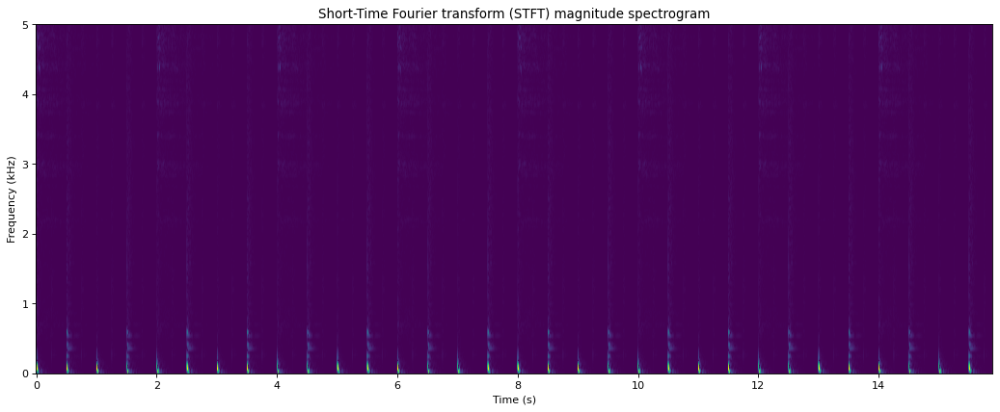

In [2]:
#my code
#use the drumloop120_mono.wav
path = 'C:\\Users\\ioric\\Desktop\\KTH\\Music Informatics\\Labs\\Lab3\\Files\\'
name1 = 'drumloop120_mono.wav'
audio1 = pydub.AudioSegment.from_file(path + name1, format='wav')
frame_rate1 = audio1.frame_rate
window_size = 0.03  #30ms window
window_hop_size = 0.01 #10ms hop
frame_size1 = int(frame_rate1 * window_size)
hop_size1 = int(window_hop_size * frame_rate1)
frame_rate_nov1 = frame_rate1 / hop_size1
audio1_array = 2*(np.array(audio1.get_array_of_samples()) / 2**16)
#choose channel left
if audio1.channels == 2:
    left_channel_audio1= audio1_array[::2]
    audio1_array = left_channel_audio1

#stft
time1 = np.linspace(0, len(audio1_array) / (frame_rate1), num=len(audio1_array))
frequencies1, times1, audio1_stft = signal.stft(audio1_array, fs=frame_rate1, window='hann', nperseg= frame_size1, noverlap=(frame_size1 - hop_size1), nfft=8192)  
audio1_stft_magn = np.abs(audio1_stft)
frequencies1 = frequencies1 / 1000  #for kHz

#plot stft figure for audio1
plt.figure(figsize=(16, 6), dpi=80)
plt.title('Short-Time Fourier transform (STFT) magnitude spectrogram')
plt.ylabel('Frequency (kHz)')
plt.xlabel('Time (s)')
plt.ylim((0, 5))
plt.pcolormesh(times1, frequencies1, audio1_stft_magn)
plt.show()

Then apply logarithmic compression (equation 6.5). Then the log-magnitude spectrum looks as follows for me (with gamma=100):

![](https://drive.google.com/uc?id=1F3Y3_iHy6tIZq2guIeQXIQIKPaONTzNO)

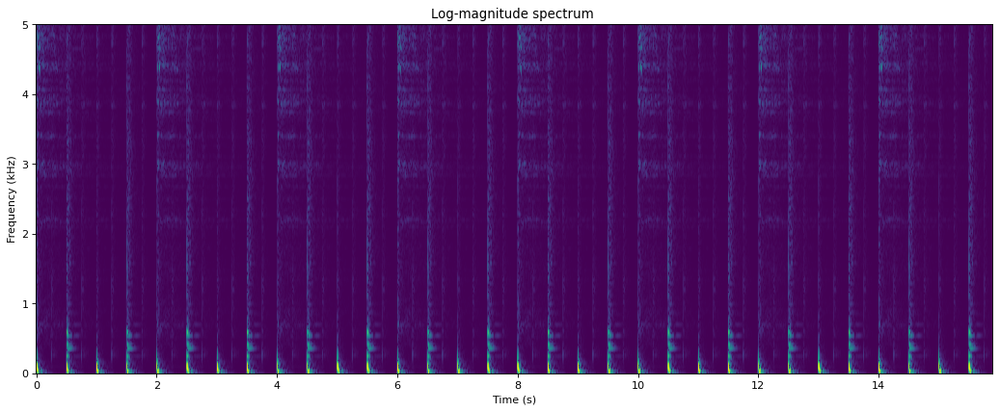

In [3]:
#my code
gamma = 100
#book formula
log_compressed_spectrum1 = np.log(audio1_stft_magn*gamma + 1)

#plot log-magnitude figure for audio1
plt.figure(figsize=(16, 6), dpi=80)
plt.title('Log-magnitude spectrum ')
plt.ylabel('Frequency (kHz)')
plt.xlabel('Time (s)')
plt.ylim((0,5))
plt.pcolormesh(times1, frequencies1, log_compressed_spectrum1)
plt.show()

The next step is to compute the difference over time, and to do what is referred to as half-wave rectification in the book (equation 6.6). Plot the obtained matrix, which looks for me as follows:

![](https://drive.google.com/uc?id=17LaxEAAliDfaQ72V807iw4y9FkUdV_SK)

As you can see, the impulses of the drum onsets are emphasized in this representation. 

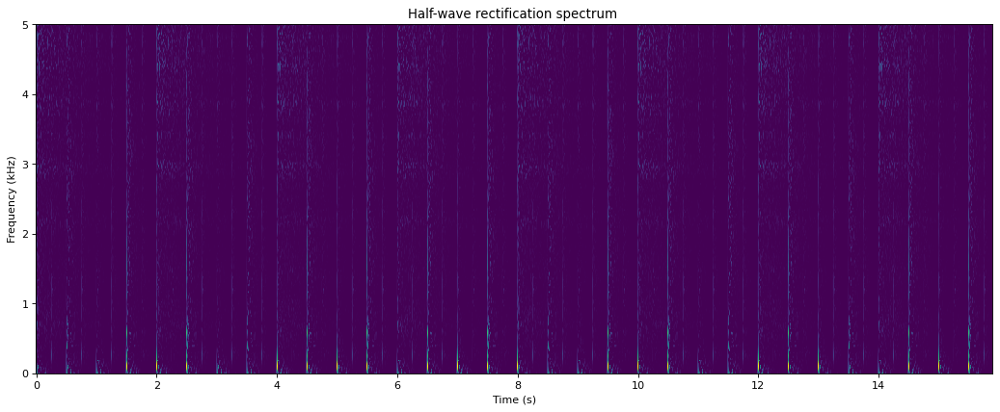

In [4]:
#my code
K = log_compressed_spectrum1.shape[0]
N = log_compressed_spectrum1.shape[1]
#print(K)
#print(N)

difference_time_matrix1 = np.zeros_like(log_compressed_spectrum1)

#formula 6.6
for k in range(K):
    difference_time = np.zeros(N)
    difference_time[1:] =  np.diff(log_compressed_spectrum1[k])
    difference_time_matrix1[k] = np.max([np.zeros(N), difference_time], axis=0)


#plot log-magnitude figure for audio1
plt.figure(figsize=(16, 6), dpi=80)
plt.title('Half-wave rectification spectrum ')
plt.ylabel('Frequency (kHz)')
plt.xlabel('Time (s)')
plt.ylim((0,5))
plt.pcolormesh(times1, frequencies1, difference_time_matrix1)
plt.show()

Now you add this matrix along the columns to get a single vector, which looks as the blue line in the plot below.

![](https://drive.google.com/uc?id=1-iC2NFpeOx65vsbhiyk7-sWZ1NSljWde)

The yellow line shows the local average function (equation 6.7, mu(n)) that we will use for post processing. Hint: in order to obtain the local average function in python you can use the numpy function convolve(), if you google for "moving average" and "np.convolve" you will find examples.

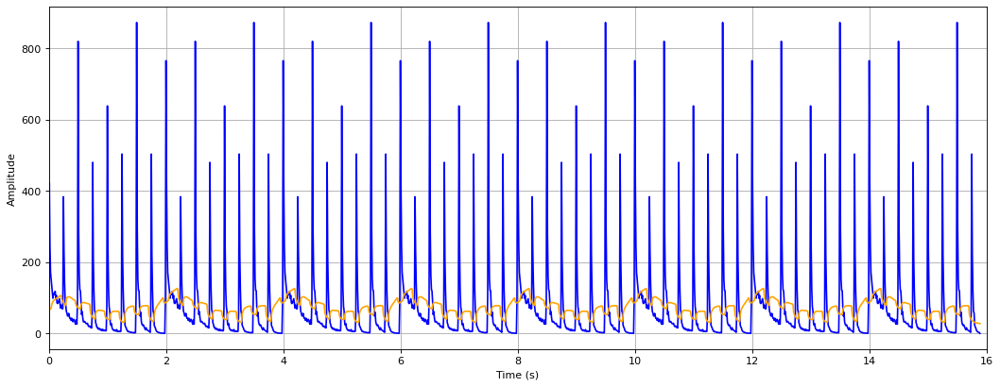

In [5]:
#my code
   
#sum columns of difference_time_matrix and store in 1D array
difference_time_matrix_added1 = np.sum(difference_time_matrix1, axis=0)
#print(difference_time_matrix_added1)

#formula 6.7
M = frame_rate_nov1
M1 = int(np.ceil(frame_rate_nov1 * 0.2))
K1 = difference_time_matrix_added1.shape[0]
local_average1 = np.zeros(K1)     
for m in range(K1):
    alpha = max(m - M1, 0)
    beta = min(m + M1 + 1, K1)
    local_average1[m] = (1 / (2 * M1 + 1)) * np.sum(difference_time_matrix_added1[alpha:beta])
#print(local_average1)
plt.figure(figsize=(16, 6), dpi=80)
plt.grid()
plt.xlim((0, 16))
plt.xlabel('Time (s)')
plt.ylabel('Amplitude')
plt.plot(times1, difference_time_matrix_added1, color='blue')
plt.plot(times1, local_average1, color='orange') 
plt.show()

When you subtract mu(n) from the spectral flux vector, and keep only positive values (equation 6.8), you obtain the final spectral novelty function. In addition, normalize the obtained vector so that the maximum is 1. It looks as follows for me (the blue line):

![](https://drive.google.com/uc?id=1rCRnhHkc_sR2d-wGIojRbmkOAAJrwmbb)


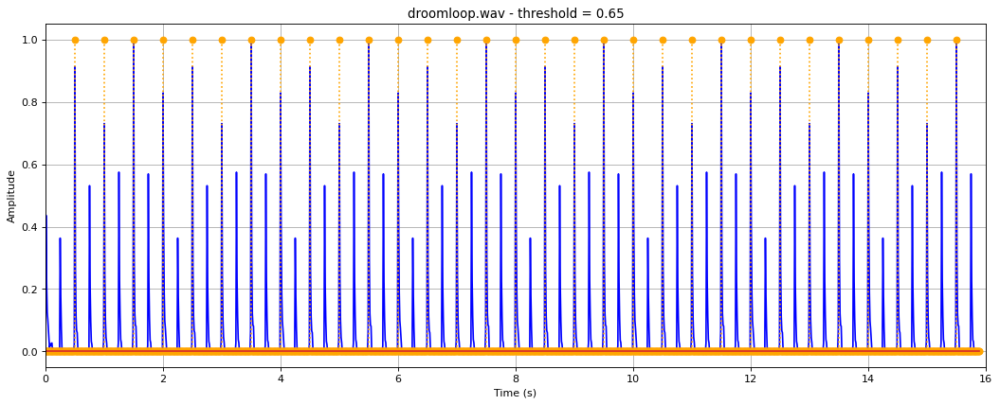

In [6]:
#my code

final_spectral_novelty_function1 = difference_time_matrix_added1 - local_average1
#print('MINIMO PRIMA')
#print(np.min(final_spectral_novelty_function1))
for i in range(len(local_average1)):
    if final_spectral_novelty_function1[i] < 0:
        final_spectral_novelty_function1[i] = 0

#print('MINIMO DOPO')
#print(np.min(final_spectral_novelty_function1))
 
normalized_final_spectral_novelty_function1 = final_spectral_novelty_function1 / np.max(final_spectral_novelty_function1)
#print(np.max(normalized_final_spectral_novelty_function1))
threshold_array1 = np.zeros(len(normalized_final_spectral_novelty_function1))
#print(threshold_array1.shape)
threshold1 = 0.65
for i in range(len(threshold_array1)):
    if normalized_final_spectral_novelty_function1[i] >= threshold1:
        threshold_array1[i] = 1

plt.figure(figsize=(16, 6), dpi=80)
plt.title('droomloop.wav - threshold = 0.65')
plt.grid()
plt.xlim((0, 16))
plt.xlabel('Time (s)')
plt.ylabel('Amplitude')
plt.plot(times1, normalized_final_spectral_novelty_function1, color='blue') 
plt.stem(times1, threshold_array1, linefmt = (':' ,'orange'))
plt.show()

What is the value you need to set for the threshold to detect all onsets? Try it with another sound file, is the value the same?

Do you observe any other problems with the obtained onset detection?



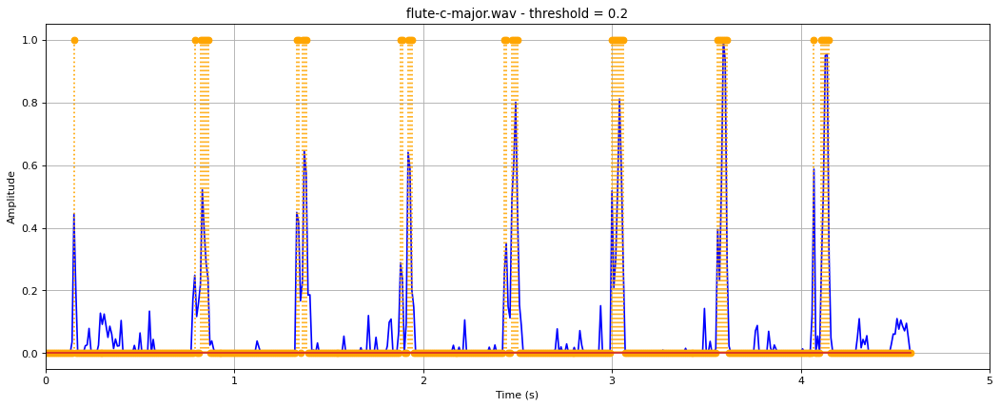

In [7]:
#my code
#use the flute-c-major.wav
path = 'C:\\Users\\ioric\\Desktop\\KTH\\Music Informatics\\Labs\\Lab3\\Files\\'
#name2 = 'cretansyrtos.wav'
name2 = 'flute-c-major.wav'
audio2 = pydub.AudioSegment.from_file(path + name2, format='wav')
frame_rate2 = audio2.frame_rate
window_size = 0.03  #30ms window
window_hop_size = 0.01 #10ms hop
frame_size2 = int(frame_rate2 * window_size)
hop_size2 = int(window_hop_size * frame_rate2)
frame_rate_nov2 = frame_rate2 / hop_size2
audio2_array = 2*(np.array(audio2.get_array_of_samples()) / 2**16)
#choose channel left
if audio2.channels == 2:
    left_channel_audio2= audio2_array[::2]
    audio2_array = left_channel_audio2

#stft
time2 = np.linspace(0, len(audio2_array) / (frame_rate2), num=len(audio2_array))
frequencies2, times2, audio2_stft = signal.stft(audio2_array, fs=frame_rate2, window='hann', nperseg= frame_size2, noverlap=(frame_size2 - hop_size2), nfft=8192)  
audio2_stft_magn = np.abs(audio2_stft)
frequencies2 = frequencies2 / 1000  #for kHz

gamma = 100

log_compressed_spectrum2 = np.log(audio2_stft_magn*gamma + 1)

K2 = log_compressed_spectrum2.shape[0]
N2 = log_compressed_spectrum2.shape[1]
#print(K)
#print(N)

difference_time_matrix2 = np.zeros_like(log_compressed_spectrum2)

#formula 6.6
for k in range(K2):
    difference_time = np.zeros(N2)
    difference_time[1:] =  np.diff(log_compressed_spectrum2[k])
    difference_time_matrix2[k] = np.max([np.zeros(N2), difference_time], axis=0)


#sum columns of difference_time_matrix and store in 1D array
difference_time_matrix_added2 = np.sum(difference_time_matrix2, axis=0)
#print(difference_time_matrix_added1)

#formula 6.7
M2 = int(np.ceil(frame_rate_nov2 * 0.2))
K2 = difference_time_matrix_added2.shape[0]
local_average2 = np.zeros(K2)
        
for m in range(K2):
    alpha = max(m - M2, 0)
    beta = min(m + M2 + 1, K2)
    local_average2[m] = (1 / (2 * M2 + 1)) * np.sum(difference_time_matrix_added2[alpha:beta])



final_spectral_novelty_function2 = difference_time_matrix_added2 - local_average2
#print('MINIMO PRIMA')
#print(np.min(final_spectral_novelty_function1))
for i in range(len(local_average2)):
    if final_spectral_novelty_function2[i] < 0:
        final_spectral_novelty_function2[i] = 0

#print('MINIMO DOPO')
#print(np.min(final_spectral_novelty_function1))
 
normalized_final_spectral_novelty_function2 = final_spectral_novelty_function2 / np.max(final_spectral_novelty_function2)
#print(np.max(normalized_final_spectral_novelty_function1))
threshold_array2 = np.zeros(len(normalized_final_spectral_novelty_function2))
#print(threshold_array1.shape)
threshold2 = 0.2
for i in range(len(threshold_array2)):
    if normalized_final_spectral_novelty_function2[i] >= threshold2:
        threshold_array2[i] = 1

plt.figure(figsize=(16, 6), dpi=80)
plt.title('flute-c-major.wav - threshold = 0.2')
plt.grid()
plt.xlim((0, 5))
plt.xlabel('Time (s)')
plt.ylabel('Amplitude')
plt.plot(times2, normalized_final_spectral_novelty_function2, color='blue') 
plt.stem(times2, threshold_array2, linefmt = (':' ,'orange'))
plt.show()


Considering the droomloop.wav file, it can be noticed that applying a threshold of 0.65, or slightly lower, is suitable in order to detect all onsets. When trying instead with a different audio file, namely the flute-c-major.wav, it can be seen that a suitable threshold value must be lower, in our case 0.4 may be suitable. Lowering the value of the threshold to 0.2 enables us to detect all the onsets but at the same time it creates more false positives. Flute notes create subtle shifts in their harmonic content as opposed to the quick transients of percussion instruments. Probably due to that, onset detection techniques that rely mostly on abrupt amplitude fluctuations may not be as effective. For example, in this case there can be more onsets detected than their real number. 

## Part 2.2 Spectral-based novelty by madmom

Madmom is a python toolbox that does some state-of-the-art rhythm processing for you. The repository is here (along with some tutorials):

https://github.com/CPJKU/madmom

In order to get better novelty features, you can use the code in the following tutorial as starting point:

https://github.com/CPJKU/madmom_tutorials/blob/master/onset_detection.ipynb

You can **run this tutorial as an addition, if you want to understand more** about state-of-the-art signal processing.

In order to use madmom in colab, I have to install it as follows, and to restart the runtime...which means this is better done in a separate python notebook. In order to re-import all libraries and create all needed variables again this separate notebook should start as:



In [8]:
# Install python library madmom, for onset detection and beat tracking
#!pip install --force-reinstall madmom ORIGINAL BY PROF
#!pip install --force-reinstall --user --no-warn-script-location madmom
#!pip install --upgrade --user https://github.com/CPJKU/madmom/archive/master.zip #USED THIS ONE AND ADDED "modules" MODUULE BY HAND IN PC FOLDER
#!pip install madmom

In [5]:
#!pip install pydub

In [9]:
import librosa
import librosa.display
import os, sys
from scipy import signal
import pydub
import matplotlib
import matplotlib.pyplot as plt
import numpy as np
#np.random.mtrand = numpy.random._mtrand
#from collections import MutableSequence
import madmom
#from madmom import evaluation
#from madmom import module

from scipy.ndimage import maximum_filter
import IPython.display as ipd

filename1 = 'cretansyrtos.wav'#put your file
root_path = 'gdrive/My Drive/Teaching/DT2470/lab2/labdata/'#put your path

In [45]:
#from google.colab import drive
#drive.mount('/content/gdrive')

## Part 2.3 Compute a Fourier tempogram

We will use the above spectral-based novelty function as an input, to compute a tempogram. From this tempogram, we can get an estimate of the tempo of a piece.

Again, produce the figures that I show below. I use the drumloop again, but you can use more interesting music files as well, for instance I provided the "cretansyrtos.wav" as an example of some Cretan folk dance.

So, as a starting point, you need to compute the spectral novelty function (equation 6.8) for whatever sound you intend to use.

The Fourier tempogram then is nothing but the STFT magnitude of the novelty function, with the frequency values mapped to tempo values (equation 6.24). Below you see what I get for a window size of 8 seconds, and a hop size of 0.5 seconds: 

![](https://drive.google.com/uc?id=1vgbnAiJ_vlGeO44j_syyIlTy_Z6FyiHm)

The red line in the above plot is the tempo estimate that I get, when I look for the maximum of the tempogram in each column in a range from 100 to 200 bpm. Implement this tempo estimation, and report also what you obtain when you do not constrain it to a specific tempo range.

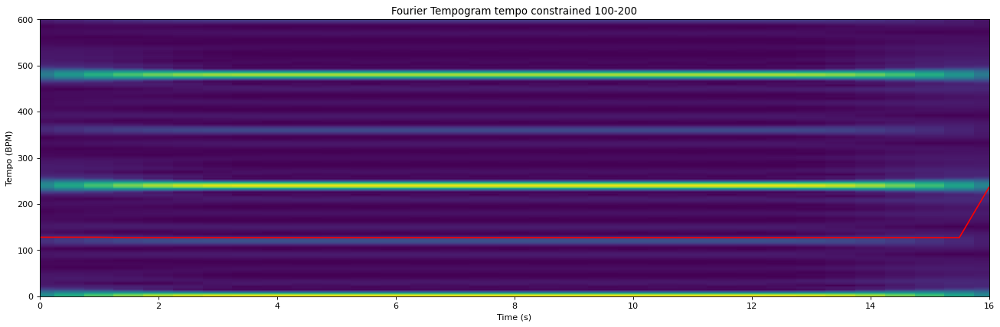

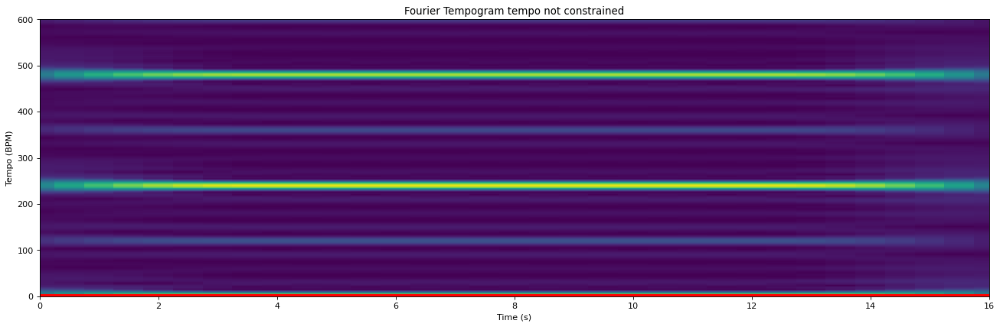

In [10]:
#my code
#use the drumloop120_mono.wav
window_size_specs = 8
hop_size_specs = 0.5
path = 'C:\\Users\\ioric\\Desktop\\KTH\\Music Informatics\\Labs\\Lab3\\Files\\'
#name2 = 'cretansyrtos.wav'
name4 = 'drumloop120_mono.wav'
audio2 = pydub.AudioSegment.from_file(path + name4, format='wav')
frame_rate2 = audio2.frame_rate
window_size = 0.03  #30ms window
window_hop_size = 0.01 #10ms hop
frame_size2 = int(frame_rate2 * window_size)
hop_size2 = int(window_hop_size * frame_rate2)
frame_rate_nov2 = frame_rate2 / hop_size2
audio2_array = 2*(np.array(audio2.get_array_of_samples()) / 2**16)
#choose channel left
if audio2.channels == 2:
    left_channel_audio2= audio2_array[::2]
    audio2_array = left_channel_audio2

#stft
time2 = np.linspace(0, len(audio2_array) / (frame_rate2), num=len(audio2_array))
frequencies2, times2, audio2_stft = signal.stft(audio2_array, fs=frame_rate2, window='hann', nperseg= frame_size2, noverlap=(frame_size2 - hop_size2), nfft=8192)  
audio2_stft_magn = np.abs(audio2_stft)
frequencies2 = frequencies2 / 1000  #for kHz

gamma = 100

log_compressed_spectrum2 = np.log(audio2_stft_magn*gamma + 1)

K2 = log_compressed_spectrum2.shape[0]
N2 = log_compressed_spectrum2.shape[1]
#print(K)
#print(N)

difference_time_matrix2 = np.zeros_like(log_compressed_spectrum2)

#formula 6.6
for k in range(K2):
    difference_time = np.zeros(N2)
    difference_time[1:] =  np.diff(log_compressed_spectrum2[k])
    difference_time_matrix2[k] = np.max([np.zeros(N2), difference_time], axis=0)


#sum columns of difference_time_matrix and store in 1D array
difference_time_matrix_added2 = np.sum(difference_time_matrix2, axis=0)
#print(difference_time_matrix_added1)

#formula 6.7
M2 = int(np.ceil(frame_rate_nov2 * 0.2))
K2 = difference_time_matrix_added2.shape[0]
local_average2 = np.zeros(K2)
        
for m in range(K2):
    alpha = max(m - M2, 0)
    beta = min(m + M2 + 1, K2)
    local_average2[m] = (1 / (2 * M2 + 1)) * np.sum(difference_time_matrix_added2[alpha:beta])



final_spectral_novelty_function2 = difference_time_matrix_added2 - local_average2
#print('MINIMO PRIMA')
#print(np.min(final_spectral_novelty_function1))
for i in range(len(local_average2)):
    if final_spectral_novelty_function2[i] < 0:
        final_spectral_novelty_function2[i] = 0

#print('MINIMO DOPO')
#print(np.min(final_spectral_novelty_function1))
 
normalized_final_spectral_novelty_function2 = final_spectral_novelty_function2 / np.max(final_spectral_novelty_function2)
#print(np.max(normalized_final_spectral_novelty_function1))
threshold_array2 = np.zeros(len(normalized_final_spectral_novelty_function2))
#print(threshold_array1.shape)
threshold2 = 0.7
for i in range(len(threshold_array2)):
    if normalized_final_spectral_novelty_function2[i] >= threshold2:
        threshold_array2[i] = 1

frame_size_spectrogram = int(frame_rate_nov2*window_size_specs)
hop_size_spectrogram = int(frame_rate_nov2*hop_size_specs)

frequency_spectrogram, time_spectrogram, stft_spectrogram = signal.stft(normalized_final_spectral_novelty_function2, fs=frame_rate_nov2, window='hann', nfft=8192, nperseg=frame_size_spectrogram, noverlap=(frame_size_spectrogram - hop_size_spectrogram))

stft_spectrogram_magn = np.abs(stft_spectrogram)
tempo_spectrogram = frequency_spectrogram * 60  #1Hz is equal to 60BPM
portion_100_200_spectrogram = stft_spectrogram_magn[(tempo_spectrogram>=100) & (tempo_spectrogram<200)]
portion_considered_spectrogram1 = np.argmax(portion_100_200_spectrogram,axis=0) + 100 #shift by 100 (the lower bound) to get the correct one
portion_considered_spectrogram2 = np.argmax(stft_spectrogram_magn,axis=0) #no shift in this case since it is not constrained to a tempo range
    
plt.figure(figsize=(20, 6), dpi=80)
plt.title('Fourier Tempogram tempo constrained 100-200')
plt.pcolormesh(time_spectrogram, tempo_spectrogram, stft_spectrogram_magn)
plt.plot(time_spectrogram,portion_considered_spectrogram1 , 'r')
plt.xlabel('Time (s)')
plt.xlim((0,16))
plt.ylabel('Tempo (BPM)')
plt.ylim((0,600))
plt.show()

plt.figure(figsize=(20, 6), dpi=80)
plt.title('Fourier Tempogram tempo not constrained')
plt.pcolormesh(time_spectrogram, tempo_spectrogram, stft_spectrogram_magn)
plt.plot(time_spectrogram,portion_considered_spectrogram2 , 'r', linewidth=6.5)
plt.xlabel('Time (s)')
plt.xlim((0,16))
plt.ylabel('Tempo (BPM)')
plt.ylim((0,600))
plt.show()


## Considerations
In tempo estimation, constraining the tempo range for example to 100-200 bpm, focuses the analysis on likely tempos, improving accuracy. It filters out harmonics and minimizes the impact of low-frequency noise near zero. Unconstrained range instead allows the consideration of irrelevant tempos, reducing reliability. The estimated tempo being zero mostly means a lack of meaningful tempo information that could be improved by constraining the tempo range.

## Part 2.4 Beat Tracking

In this part you will use two beat trackers, which are available in python:



1.   The librosa beat tracker, which is the dynamic programming approach presented in the book. An example for how to run the librosa beat tracker: https://musicinformationretrieval.com/beat_tracking.html

2.   And the madmom beat tracker, which is using deep learning. 

Apply both beat trackers to audio examples having the following three characteristics:

1. stable tempo, strong onsets (for instance, the drum loop example) 
2. instable tempo, strong onsets (for instance, the cretansyrtos) 
3. weak energy onsets (for instance, a string quartet or a choir performance) 

Provide plots for the waveform with the beats overlaid (using vlines or stem). Also listen to the beat tracking results, which you can do with code that looks somewhat as follows:



In [ ]:
import IPython.display as ipd
clicks = librosa.clicks(beat_times, sr=sr, length=len(x))
ipd.Audio(x + clicks, rate=sr)

For tracking with madmom, your code should look someshat as shown below. Note that in order to run madmom, I need to install it with the --force-install option, so it might be better to do that in a separate python notebook. A nice example that applies both librosa and madmom is here: https://www.analyticsvidhya.com/blog/2018/02/audio-beat-tracking-for-music-information-retrieval/

In [ ]:
import madmom
proc = madmom.features.beats.DBNBeatTrackingProcessor(fps=100)
act = madmom.features.beats.RNNBeatProcessor()(os.path.join(root_path,filename1))
beat_times = proc(act)

Report what differences you observe (mainly by listening to the audio with the clicks for the beats) between the beat tracking outputs obtained from the two algorithms. Why do you think these differences emerge? (Given what you know from the book chapter and the from example on the analyticsvidhya website)

The plot of waveform and beats I get for the cretansyrtos example using librosa:

![](https://drive.google.com/uc?id=1l1YtJjrCHzaGUDEQ9O4UBafarf983CvW)

The plot of waveform and beats I get for the cretansyrtos example using madmom:

![](https://drive.google.com/uc?id=1L5LHO2EwgHgg8ypuj57gaj2j0eboCa5k)

# Drum Loop


In [11]:
##DRUMS
import IPython.display as ipd
import librosa
path = 'C:\\Users\\ioric\\Desktop\\KTH\\Music Informatics\\Labs\\Lab3\\Files\\'
name1 = 'drumloop120_mono.wav'

audio_drum, audio_drum_frame_rate = librosa.load(path + name1)
time1 = np.linspace(0, len(audio_drum) / (audio_drum_frame_rate), num=len(audio_drum))

tempo_drum_librosa, beat_times_drum_librosa = librosa.beat.beat_track(y=audio_drum, sr=audio_drum_frame_rate, start_bpm=120, units='time')

proc_drum = madmom.features.beats.DBNBeatTrackingProcessor(fps=100)
act_drum = madmom.features.beats.RNNBeatProcessor()(path+name1)
beat_times_drum_madmom = proc_drum(act_drum) 

def plot_wave_beats(time, audio_array, title, beat):
        plt.figure(figsize=(20, 6), dpi=80)
        plt.plot(time, audio_array)
        plt.title(title)
        plt.xlabel('Time (s)')
        plt.ylabel('Amplitude')
        plt.vlines(beat, -1, 1, color='r')
        plt.ylim(-1, 1)
        plt.grid()

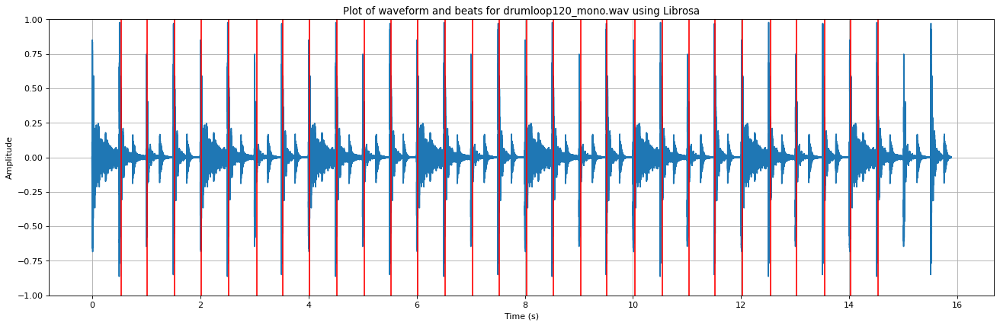

In [12]:
#Plot of waveform and beats for drumloop120_mono.wav using Librosa
plot_wave_beats(time1, audio_drum, 'Plot of waveform and beats for drumloop120_mono.wav using Librosa', beat_times_drum_librosa)

In [13]:
#drum audio with the clicks for the beats Librosa
clicks_drum_librosa = librosa.clicks(times=beat_times_drum_librosa, sr=audio_drum_frame_rate, length=len(audio_drum))
ipd.Audio(audio_drum + clicks_drum_librosa , rate=audio_drum_frame_rate)

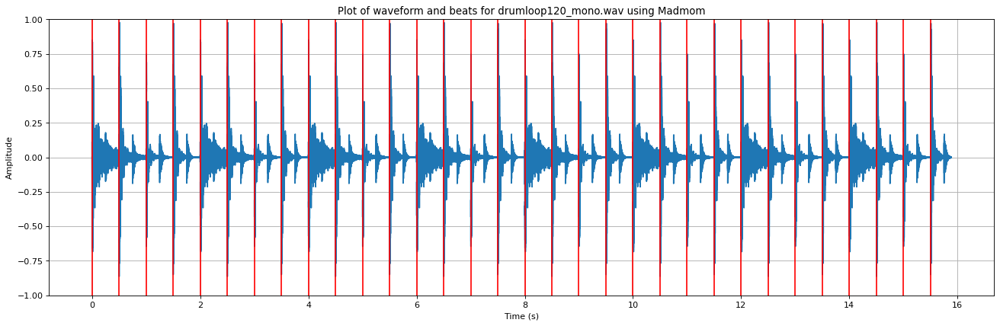

In [14]:
#Plot of waveform and beats for drumloop120_mono.wav using Madmom
plot_wave_beats(time1, audio_drum, 'Plot of waveform and beats for drumloop120_mono.wav using Madmom', beat_times_drum_madmom)

In [15]:
#drum audio with the clicks for the beats Madmom
clicks_drum_madmom = librosa.clicks(times=beat_times_drum_madmom, sr=audio_drum_frame_rate, length=len(audio_drum))
ipd.Audio(audio_drum + clicks_drum_madmom, rate=audio_drum_frame_rate)

## Evaluation of drumloop120_mono.wav beat estimates
Overall both beat estimates are good but the madmom estimate is more accurate when it comes to the start and the end of the audio file. The approach with deep learning manages to detect beats in these two phases that are ignored in the estimates by dynamical programming instead. In this case, due to clear onsets, both perform good.

# Cretansyrtos


In [ ]:
##DRUMS
import IPython.display as ipd
import librosa
path = 'C:\\Users\\ioric\\Desktop\\KTH\\Music Informatics\\Labs\\Lab3\\Files\\'
name2 = 'cretansyrtos.wav'

audio_cretan, audio_cretan_frame_rate = librosa.load(path + name2)
time2 = np.linspace(0, len(audio_cretan) / (audio_cretan_frame_rate), num=len(audio_cretan))

tempo_cretan_librosa, beat_times_cretan_librosa = librosa.beat.beat_track(y=audio_cretan, sr=audio_cretan_frame_rate, start_bpm=120, units='time')

proc_cretan = madmom.features.beats.DBNBeatTrackingProcessor(fps=100)
act_cretan = madmom.features.beats.RNNBeatProcessor()(path+name2)
beat_times_cretan_madmom = proc_cretan(act_cretan) 

def plot_wave_beats(time, audio_array, title, beat):
        plt.figure(figsize=(20, 6), dpi=80)
        plt.plot(time, audio_array)
        plt.title(title)
        plt.xlabel('Time (s)')
        plt.ylabel('Amplitude')
        plt.vlines(beat, -1, 1, color='r')
        plt.ylim(-1, 1)
        plt.xlim(0, 30)
        plt.grid()

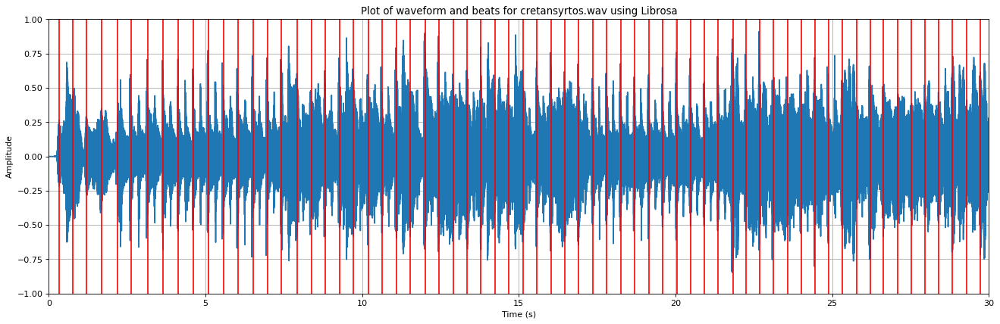

In [17]:
#Plot of waveform and beats for cretansyrtos.wav using Librosa
plot_wave_beats(time2, audio_cretan, 'Plot of waveform and beats for cretansyrtos.wav using Librosa', beat_times_cretan_librosa)

In [18]:
#cretansyrtos audio with the clicks for the beats Librosa
clicks_cretan_librosa = librosa.clicks(times=beat_times_cretan_librosa, sr=audio_cretan_frame_rate, length=len(audio_cretan))
ipd.Audio(audio_cretan + clicks_cretan_librosa , rate=audio_cretan_frame_rate)

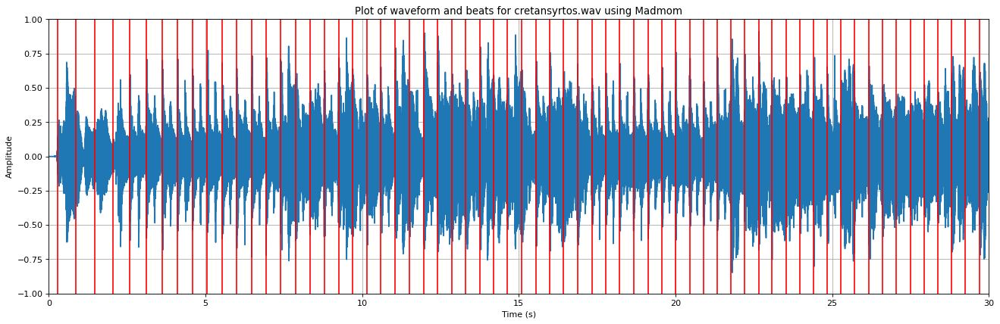

In [19]:
#Plot of waveform and beats for cretansyrtos.wav using Madmom
plot_wave_beats(time2, audio_cretan, 'Plot of waveform and beats for cretansyrtos.wav using Madmom', beat_times_cretan_madmom)

In [20]:
#cretansyrtos audio with the clicks for the beats Madmom
clicks_cretan_madmom = librosa.clicks(times=beat_times_cretan_madmom, sr=audio_cretan_frame_rate, length=len(audio_cretan))
ipd.Audio(audio_cretan + clicks_cretan_madmom, rate=audio_cretan_frame_rate)

## Evaluation of cretansyrtos.wav beat estimates
The beat estimates obtained with madmom through deep learning are more accurate than the beat estimates with dynamical programming. As can be noticed by listening to the results, for example the beats estimated by madmom follow correctly the slower tempo at the beginning of the audio file. Instead, as can be noticed, the estimates computed through librosa keep mostly the same distance in time thus not really adapting to the song.

# Choir


In [21]:
##DRUMS
import IPython.display as ipd
import librosa
path = 'C:\\Users\\ioric\\Desktop\\KTH\\Music Informatics\\Labs\\Lab3\\Files\\'
name3 = 'choir.wav'

audio_choir, audio_choir_frame_rate = librosa.load(path + name3)
time3 = np.linspace(0, len(audio_choir) / (audio_choir_frame_rate), num=len(audio_choir))

tempo_choir_librosa, beat_times_choir_librosa = librosa.beat.beat_track(y=audio_choir, sr=audio_choir_frame_rate, start_bpm=110, units='time')

proc_choir = madmom.features.beats.DBNBeatTrackingProcessor(fps=100)
act_choir = madmom.features.beats.RNNBeatProcessor()(path+name3)
beat_times_choir_madmom = proc_choir(act_choir) 

def plot_wave_beats(time, audio_array, title, beat):
        plt.figure(figsize=(20, 6), dpi=80)
        plt.plot(time, audio_array)
        plt.title(title)
        plt.xlabel('Time (s)')
        plt.ylabel('Amplitude')
        plt.vlines(beat, -1, 1, color='r')
        plt.ylim(-1, 1)
        plt.xlim(0, 15)
        plt.grid()

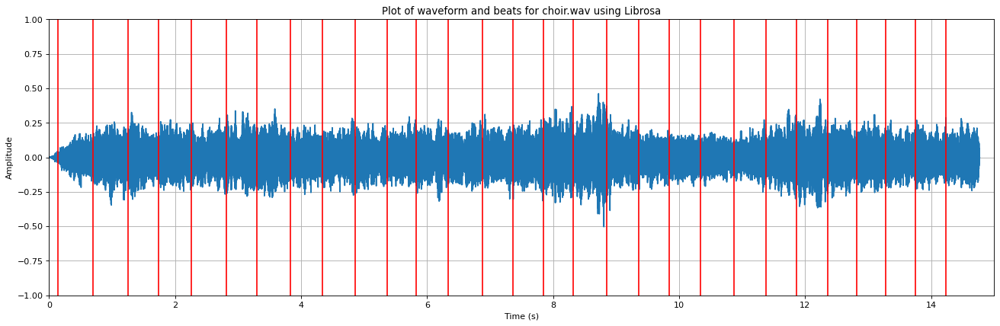

In [22]:
#Plot of waveform and beats for choir.wav using Librosa
plot_wave_beats(time3, audio_choir, 'Plot of waveform and beats for choir.wav using Librosa', beat_times_choir_librosa)

In [23]:
#choir audio with the clicks for the beats Librosa
clicks_choir_librosa = librosa.clicks(times=beat_times_choir_librosa, sr=audio_choir_frame_rate, length=len(audio_choir))
ipd.Audio(audio_choir + clicks_choir_librosa , rate=audio_choir_frame_rate)

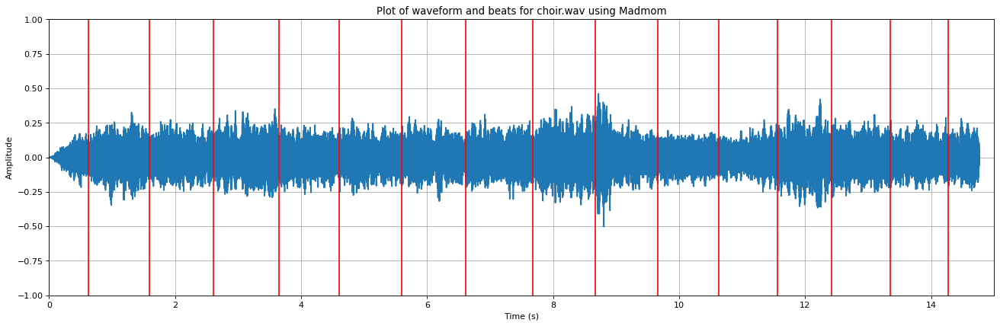

In [24]:
#Plot of waveform and beats for choir.wav using Madmom
plot_wave_beats(time3, audio_choir, 'Plot of waveform and beats for choir.wav using Madmom', beat_times_choir_madmom)

In [25]:
#choir audio with the clicks for the beats Madmom
clicks_choir_madmom = librosa.clicks(times=beat_times_choir_madmom, sr=audio_choir_frame_rate, length=len(audio_choir))
ipd.Audio(audio_choir + clicks_choir_madmom, rate=audio_choir_frame_rate)

## Evaluation of choir.wav beat estimates
In the choir example, the dynamical programming beat estimation is almost fixed and it does not feel like it is properly right. Instead when using deep learning with madmom the beats are at times when the voices are almost shifting to a new note. It tracks better these shifts overall, but still it is not very accurate. The beat is hard to be properly detected in this case as multiple voices may have soft onsets, with slow energy increases, and blurred note transitions.